# Cardiovascular Diseases Risk Prediction

## Problem Statement :

- Heart disease continues to be a significant global health concern, impacting millions of lives and posing a substantial burden on healthcare systems. Early detection and accurate prediction of heart disease play a crucial role in managing and preventing its onset, as well as improving patient outcomes. Over the years, advancements in medical research, technology, and data analysis have significantly enhanced our understanding of heart disease prediction. This brief introduction aims to provide an overview of the progress made in this field, highlighting key methodologies and approaches utilized in predicting heart disease. By exploring the various risk factors, diagnostic tools, and emerging trends, we can gain valuable insights into the evolving landscape of heart disease prediction, paving the way for more proactive and personalized healthcare strategies.

### Dataset Attributes :

- General_Health
- Checkup
- Exercise
- Heart_Disease
- Skin_Cancer
- Other_Cancer
- Depression
- Diabetes
- Arthritis
- Sex
- Age_Category
- Height_(cm)
- Weight_(kg)
- BMI
- Smoking_History
- Alcohol_Consumption
- Fruit_Consumption
- Green_Vegetables_Consumption
- FriedPotato_Consumption

### Notebook Contents :

- Dataset Information
  - Data Cleaning
- Exploratory Data Analysis (EDA)
  - Feature Engineering
- Modeling
- Conclusion

### PROJECT OBJECTIVES:

- Analyze the data
- Extract the hidden trends and patterns
- Group the reviewers based upon health conditions and risk
- Analyze Each clusters and find out the nature for better medical recommendations
- Examine which Machine Learning Algorithm is most suitable for the dataset

### Importing the Libraries 

In [97]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import plotly.express as px
import plotly.subplots as sp
import plotly.graph_objs as go
import matplotlib.pyplot as plt
colors = px.colors.sequential.Plasma_r

import pickle

# Preprocessing
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from imblearn.over_sampling import SMOTE

# Models
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier

# Metrics
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report
from sklearn.metrics import roc_curve, auc

# Warnings
import warnings 
warnings. filterwarnings('ignore')

### Loading the dataset

In [98]:
df = pd.read_csv("/Users/bhavyakalra/Desktop/Informatics/Final Project/CVD_cleaned.csv")

In [99]:
# Columns and rows in the dataset
df.shape

(308854, 19)

In [100]:
# First 5 values in the dataset
df.head()

,General_Health,Checkup,Exercise,Heart_Disease,Skin_Cancer,Other_Cancer,Depression,Diabetes,Arthritis,Sex,Age_Category,Height,Weight,BMI,Smoking_History,Alcohol_Consumption,Fruit_Consumption,Green_Vegetables_Consumption,FriedPotato_Consumption
0,Poor,Within the past 2 years,No,No,No,No,No,No,Yes,Female,70-74,150,32.66,14.54,Yes,0,30,16,12
1,Very Good,Within the past year,No,Yes,No,No,No,Yes,No,Female,70-74,165,77.11,28.29,No,0,30,0,4
2,Very Good,Within the past year,Yes,No,No,No,No,Yes,No,Female,60-64,163,88.45,33.47,No,4,12,3,16
3,Poor,Within the past year,Yes,Yes,No,No,No,Yes,No,Male,75-79,180,93.44,28.73,No,0,30,30,8
4,Good,Within the past year,No,No,No,No,No,No,No,Male,80+,191,88.45,24.37,Yes,0,8,4,0


In [101]:
# Last 5 values in the dataset
df.tail()

,General_Health,Checkup,Exercise,Heart_Disease,Skin_Cancer,Other_Cancer,Depression,Diabetes,Arthritis,Sex,Age_Category,Height,Weight,BMI,Smoking_History,Alcohol_Consumption,Fruit_Consumption,Green_Vegetables_Consumption,FriedPotato_Consumption
308849,Very Good,Within the past year,Yes,No,No,No,No,No,No,Male,25-29,168,81.65,29.05,No,4,30,8,0
308850,Fair,Within the past 5 years,Yes,No,No,No,No,Yes,No,Male,65-69,180,69.85,21.48,No,8,15,60,4
308851,Very Good,5 or more years ago,Yes,No,No,No,Yes,"Yes, but female told only during pregnancy",No,Female,30-34,157,61.23,24.69,Yes,4,40,8,4
308852,Very Good,Within the past year,Yes,No,No,No,No,No,No,Male,65-69,183,79.38,23.73,No,3,30,12,0
308853,Excellent,Within the past year,Yes,No,No,No,No,No,No,Female,45-49,160,81.19,31.71,No,1,5,12,1


In [102]:
# Data type of all the columns
df.dtypes

General_Health                   object
Checkup                          object
Exercise                         object
Heart_Disease                    object
Skin_Cancer                      object
Other_Cancer                     object
Depression                       object
Diabetes                         object
Arthritis                        object
Sex                              object
Age_Category                     object
Height                            int64
Weight                          float64
BMI                             float64
Smoking_History                  object
Alcohol_Consumption               int64
Fruit_Consumption                 int64
Green_Vegetables_Consumption      int64
FriedPotato_Consumption           int64
dtype: object

In [103]:
# Column names
df.columns

Index(['General_Health', 'Checkup', 'Exercise', 'Heart_Disease', 'Skin_Cancer',
       'Other_Cancer', 'Depression', 'Diabetes', 'Arthritis', 'Sex',
       'Age_Category', 'Height', 'Weight', 'BMI', 'Smoking_History',
       'Alcohol_Consumption', 'Fruit_Consumption',
       'Green_Vegetables_Consumption', 'FriedPotato_Consumption'],
      dtype='object')

In [104]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 308854 entries, 0 to 308853
Data columns (total 19 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   General_Health                308854 non-null  object 
 1   Checkup                       308854 non-null  object 
 2   Exercise                      308854 non-null  object 
 3   Heart_Disease                 308854 non-null  object 
 4   Skin_Cancer                   308854 non-null  object 
 5   Other_Cancer                  308854 non-null  object 
 6   Depression                    308854 non-null  object 
 7   Diabetes                      308854 non-null  object 
 8   Arthritis                     308854 non-null  object 
 9   Sex                           308854 non-null  object 
 10  Age_Category                  308854 non-null  object 
 11  Height                        308854 non-null  int64  
 12  Weight                        308854 non-nul

In [105]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Height,308854.0,170.615249,10.658026,91.00,163.00,170.00,178.00,241.00
Weight,308854.0,83.588655,21.343210,24.95,68.04,81.65,95.25,293.02
BMI,308854.0,28.626211,6.522323,12.02,24.21,27.44,31.85,99.33
Alcohol_Consumption,308854.0,5.096366,8.199763,0.00,0.00,1.00,6.00,30.00
Fruit_Consumption,308854.0,29.835200,24.875735,0.00,12.00,30.00,30.00,120.00
Green_Vegetables_Consumption,308854.0,15.110441,14.926238,0.00,4.00,12.00,20.00,128.00
FriedPotato_Consumption,308854.0,6.296616,8.582954,0.00,2.00,4.00,8.00,128.00


- 50th quartile of numerical columns except Height and Fruit consumption are less than that of their mean. 
- That means they are right skewed and contains extreme values or outliers.

## Data Cleaning

In [106]:
df.isna().sum()

General_Health                  0
Checkup                         0
Exercise                        0
Heart_Disease                   0
Skin_Cancer                     0
Other_Cancer                    0
Depression                      0
Diabetes                        0
Arthritis                       0
Sex                             0
Age_Category                    0
Height                          0
Weight                          0
BMI                             0
Smoking_History                 0
Alcohol_Consumption             0
Fruit_Consumption               0
Green_Vegetables_Consumption    0
FriedPotato_Consumption         0
dtype: int64

- We have no missing data

In [107]:
df.duplicated().sum()

80

In [108]:
# Removing duplicate values
df.drop_duplicates(inplace=True)
df.duplicated().sum()

0

In [109]:
df["Diabetes"].unique()

array(['No', 'Yes', 'No, pre-diabetes or borderline diabetes',
       'Yes, but female told only during pregnancy'], dtype=object)

In [110]:
# Making 'Diabetes' column values Uniform.
df['Diabetes'].replace(["No, pre-diabetes or borderline diabetes", " Yes, but female told only during pregnancy"], ["No", "Yes"], inplace = True)

In [111]:
df["Diabetes"].head()

0     No
1    Yes
2    Yes
3    Yes
4     No
Name: Diabetes, dtype: object

In [112]:
# Making 'Age_category' column a categorical value
df['Age_Category'] = df['Age_Category'].replace('18-24', 'Young')
df['Age_Category'] = df['Age_Category'].replace('25-29', 'Adult')
df['Age_Category'] = df['Age_Category'].replace('30-34', 'Adult')
df['Age_Category'] = df['Age_Category'].replace('35-39', 'Adult')
df['Age_Category'] = df['Age_Category'].replace('40-44', 'Mid-Aged')
df['Age_Category'] = df['Age_Category'].replace('45-49', 'Mid-Aged')
df['Age_Category'] = df['Age_Category'].replace('50-54', 'Mid-Aged')
df['Age_Category'] = df['Age_Category'].replace('55-59', 'Senior-Adult')
df['Age_Category'] = df['Age_Category'].replace('60-64', 'Senior-Adult')
df['Age_Category'] = df['Age_Category'].replace('65-69', 'Elderly')
df['Age_Category'] = df['Age_Category'].replace('70-74', 'Elderly')
df['Age_Category'] = df['Age_Category'].replace('75-79', 'Elderly')
df['Age_Category'] = df['Age_Category'].replace('80+', 'Elderly')
df['Age_Category'].head()

0         Elderly
1         Elderly
2    Senior-Adult
3         Elderly
4         Elderly
Name: Age_Category, dtype: object

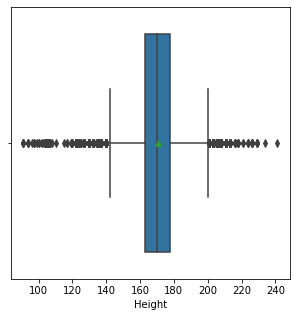

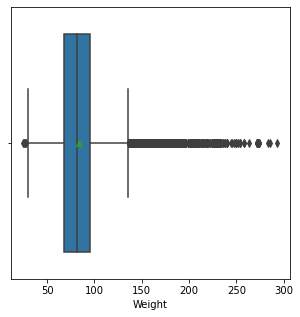

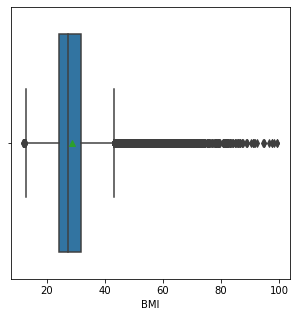

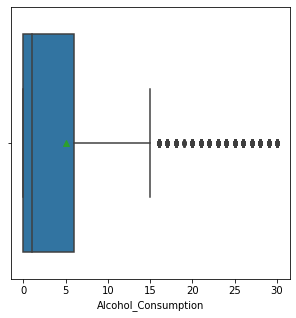

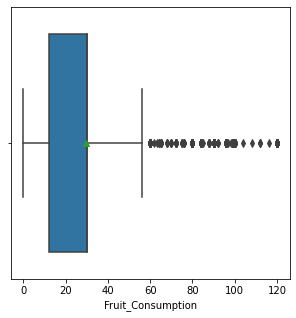

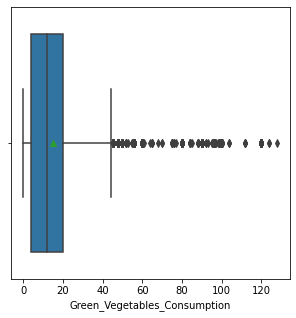

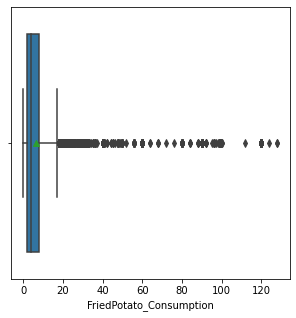

In [113]:
# Taking numerical values to check for outliers using boxplot
lst = [ 'Height', 'Weight', 'BMI','Alcohol_Consumption', 'Fruit_Consumption','Green_Vegetables_Consumption', 'FriedPotato_Consumption']
for i in lst:
    plt.figure(figsize=(5,5))
    sns.boxplot(x=i,data=df,showmeans=True)
    plt.show()

In [114]:
for i in lst:
    print("Minimium value of ",i,"is",df[i].min())
    print("Mean value of ",i,"is",df[i].mean())
    print("Maximum value of ",i,"is",df[i].max())
    print("-"*75)

Minimium value of  Height is 91
Mean value of  Height is 170.61522019341007
Maximum value of  Height is 241
---------------------------------------------------------------------------
Minimium value of  Weight is 24.95
Mean value of  Weight is 83.59039922386027
Maximum value of  Weight is 293.02
---------------------------------------------------------------------------
Minimium value of  BMI is 12.02
Mean value of  BMI is 28.626813235569596
Maximum value of  BMI is 99.33
---------------------------------------------------------------------------
Minimium value of  Alcohol_Consumption is 0
Mean value of  Alcohol_Consumption is 5.097556789107891
Maximum value of  Alcohol_Consumption is 30
---------------------------------------------------------------------------
Minimium value of  Fruit_Consumption is 0
Mean value of  Fruit_Consumption is 29.834289804193357
Maximum value of  Fruit_Consumption is 120
---------------------------------------------------------------------------
Minimium va

- From the boxplot as well as the code its very clear that there are outliers, while comparing the mean value and maximum value,the maximum value is very far from the mean value .The double cross checking is implemented because this dataset is related to health,extreme values may be possibile due to extreme medical conditions .At the same time there is another possibility that people may answer false or assumptions to the phone call based review system. Its impossible to guarantee 100 percentage that the answers may be exact.

## Removing outliers from the dataset

In [115]:
lst = [ 'Height', 'Weight', 'BMI','Alcohol_Consumption', 'Fruit_Consumption','Green_Vegetables_Consumption', 'FriedPotato_Consumption']
for i in lst:
    Q1 = df[i].quantile(0.25)
    Q3=df[i].quantile(0.75)
    IQR = Q3-Q1
    lower = Q1-3*IQR
    upper = Q3+3*IQR
    ot_cnt = ((df[i]<lower) | (df[i]>upper)).sum()
    ot_percentage = np.divide(np.multiply(ot_cnt,100),308854)
    ot_round = np.round(ot_percentage,decimals=0)
    print(i," : ",ot_cnt," : ",ot_round,"%")

Height  :  82  :  0.0 %
Weight  :  684  :  0.0 %
BMI  :  1279  :  0.0 %
Alcohol_Consumption  :  21221  :  7.0 %
Fruit_Consumption  :  19939  :  6.0 %
Green_Vegetables_Consumption  :  2889  :  1.0 %
FriedPotato_Consumption  :  11254  :  4.0 %


In [116]:
lst = [ 'Height', 'Weight', 'BMI','Alcohol_Consumption', 'Fruit_Consumption','Green_Vegetables_Consumption', 'FriedPotato_Consumption']
for i in lst:
    Q1 = df[i].quantile(0.25)
    Q3=df[i].quantile(0.75)
    IQR = Q3-Q1
    lower = Q1-3*IQR
    upper = Q3+3*IQR
    df= df[(df[i]>=lower) &(df[i]<=upper)|(df[i].isnull())]
df.reset_index(drop=True, inplace=True)
df.shape

(256262, 19)

In [117]:
print("Change in dataset after dropping the outliers"+ "\n",308854 - 256262)

Change in dataset after dropping the outliers
 52592


- Mean values of all the features for cases of heart disease and no heart disease.
- The average weight of people with heart disease is slightly higher than people without heart disease.
- The average consumption of vegetables in people with heart disease is lower than people without heart disease.

# Exploratory Data Analysis

## Checking the distribution of data

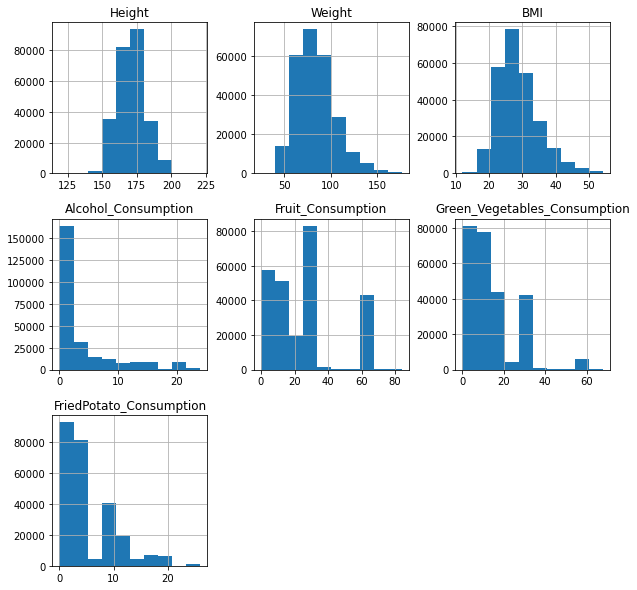

In [118]:
df.hist(figsize=(10,10));

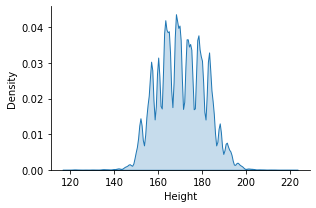

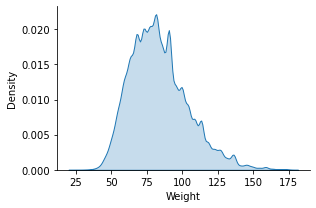

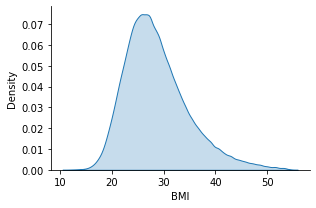

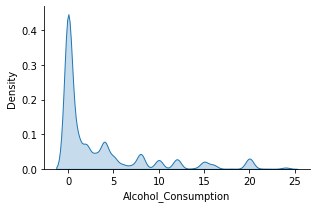

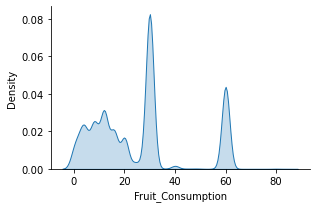

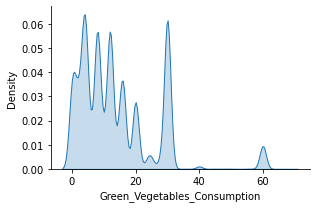

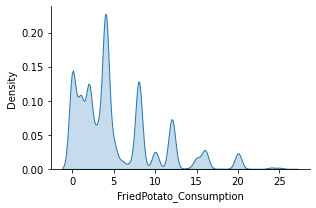

In [119]:
numerical_attributes = ['Height', 'Weight', 'BMI', 'Alcohol_Consumption', 'Fruit_Consumption', 'Green_Vegetables_Consumption', 'FriedPotato_Consumption']
for i in numerical_attributes:
    g = sns.FacetGrid(df,height=3,aspect=1.5)
    g = g.map(sns.kdeplot,i,shade=True)

- Distribution of Height is skewed
- Distribution of Weight shows right skewness
- Others are also skewed

In [120]:
col = ['Alcohol_Consumption', 'Fruit_Consumption', 'Green_Vegetables_Consumption', 'FriedPotato_Consumption']

for i in col:
    df[i] = df[i].astype(int)

- Data types of above columns were changed

## Feature engineering

In [121]:
# Define BMI ranges and labels for each group
bmi_bins = [12.02, 18.3, 26.85, 31.58, 37.8, 100]
bmi_labels = ['Underweight', 'Normal weight', 'Overweight', 'Obese I', 'Obese II']
df['bmi_group'] = pd.cut(df['BMI'], bins=bmi_bins, labels=bmi_labels, right=False)

In [122]:
df.head()

,General_Health,Checkup,Exercise,Heart_Disease,Skin_Cancer,Other_Cancer,Depression,Diabetes,Arthritis,Sex,Age_Category,Height,Weight,BMI,Smoking_History,Alcohol_Consumption,Fruit_Consumption,Green_Vegetables_Consumption,FriedPotato_Consumption,bmi_group
0,Poor,Within the past 2 years,No,No,No,No,No,No,Yes,Female,Elderly,150,32.66,14.54,Yes,0,30,16,12,Underweight
1,Very Good,Within the past year,No,Yes,No,No,No,Yes,No,Female,Elderly,165,77.11,28.29,No,0,30,0,4,Overweight
2,Very Good,Within the past year,Yes,No,No,No,No,Yes,No,Female,Senior-Adult,163,88.45,33.47,No,4,12,3,16,Obese I
3,Poor,Within the past year,Yes,Yes,No,No,No,Yes,No,Male,Elderly,180,93.44,28.73,No,0,30,30,8,Overweight
4,Good,Within the past year,No,No,No,No,No,No,No,Male,Elderly,191,88.45,24.37,Yes,0,8,4,0,Normal weight


## Identification of Risk Factors

### 1. Health Assessment 

In [123]:
fig1 = px.histogram(df, x="General_Health", color = 'General_Health', color_discrete_sequence = colors, title="1. Distribution of General Health")
fig1.update_layout(plot_bgcolor='white')
fig1.show()
print('\n', "="*80, '\n')

fig2 = px.histogram(df, x="General_Health", color = 'Heart_Disease', color_discrete_sequence = colors, barmode = 'group', title="2. General Health with respect to Heart Disease")
fig2.update_layout(plot_bgcolor='white')
fig2.show()
print('\n', "="*80, '\n')

### 2. Gender Demographic Analysis

In [124]:
sex_counts = df['Sex'].value_counts()
age_category_counts = df['Age_Category'].value_counts()

fig1 = px.bar(x=sex_counts.index, y=sex_counts.values, color=sex_counts.index, color_discrete_sequence = colors, labels={'x': 'Sex', 'y': 'Count'})
fig1.update_layout(title="1. Distribution of gender in the Dataset", xaxis_title="", yaxis_title="Count", plot_bgcolor='white')
fig1.show()
print('\n', "="*80, '\n')

fig2 = px.histogram(df, x="Sex", color='Heart_Disease', barmode='group', color_discrete_sequence= colors, title="2. Checking which gender is more susceptible to Heart Disease?")
fig2.update_layout(xaxis_title="Gender", yaxis_title="Count", legend_title="Heart Disease", xaxis_showgrid=False, yaxis_showgrid=False, plot_bgcolor='white')
fig2.show()
print('\n', "="*80, '\n')

grouped_data = df.groupby(['Sex', 'Heart_Disease'], as_index=False)['BMI'].median()
fig = px.bar(grouped_data, x='Sex', y='BMI', color='Heart_Disease', color_discrete_sequence = colors, barmode = 'group', title="3. Checking  gender and their average bmi based on heart disease?")
fig.update_layout(xaxis_title="Gender", yaxis_title="Average BMI", legend_title="Heart Disease", xaxis_showgrid=False, yaxis_showgrid=False, plot_bgcolor='white')
fig.show()

In [125]:
fig1 = px.bar(x=age_category_counts.index, y=age_category_counts.values, color=age_category_counts.index, color_discrete_sequence = colors ,labels={'x': 'Age Category', 'y': 'Count'})
fig1.update_layout(title="1. Distribution of Age Categories in the Dataset", xaxis_title="", yaxis_title="Count", plot_bgcolor='white')
fig1.show()
print('\n', "="*80, '\n')

fig2 = px.histogram(df, x="Age_Category", color='Heart_Disease', barmode='group', color_discrete_sequence= colors, title="2. Checking which age group is more susceptible to Heart Disease?")
fig2.update_layout(xaxis_title="Age_Category", yaxis_title="Count", legend_title="Heart Disease", xaxis_showgrid=False, yaxis_showgrid=False, plot_bgcolor='white')
fig2.show()
print('\n', "="*80, '\n')

grouped_data = df.groupby(['Age_Category', 'Heart_Disease'], as_index=False)['BMI'].median()
fig3 = px.bar(grouped_data, x='Age_Category', y='BMI', color='Heart_Disease', color_discrete_sequence = colors, barmode = 'group', title="3. Checking  age groups and their average bmi based on heart disease?")
fig3.update_layout(xaxis_title="Age Group", yaxis_title="Average BMI", legend_title="Heart Disease", xaxis_showgrid=False, yaxis_showgrid=False, plot_bgcolor='white')
fig3.show()

### 3. Impact of Lifestyle Analysis

In [126]:
def create_bar_chart(data, x_col, y_col, color_col, title, x_label, y_label):
    grouped_data = data.groupby([x_col, color_col]).size().reset_index(name='count')
    fig = px.bar(grouped_data, x=x_col, y=y_col, color=color_col, color_discrete_sequence=colors, title=title, labels={x_col: x_label, y_col: y_label}, barmode='group', category_orders={x_col: ["No", "Yes"], color_col: ["No", "Yes"]} )
    fig.update_layout(plot_bgcolor='white')
    fig.show()
    print('\n', "=" * 80, '\n')
    
create_bar_chart(df, 'Exercise', 'count', 'Heart_Disease', '1. Impact of Exercise on Heart Disease', 'Exercise', 'Count')
create_bar_chart(df, 'Smoking_History', 'count', 'Heart_Disease', '2. Impact of Smoking on Heart Disease', 'Smoking History', 'Count')

columns = ['Alcohol_Consumption', 'Fruit_Consumption', 'Green_Vegetables_Consumption', 'FriedPotato_Consumption']
titles = ["Alcohol Consumption", "Fruit Consumption", "Vegetables Consumption", "Potato Consumption"]

for i, col in enumerate(columns):
    grouped_data = df.groupby(['Age_Category', 'Heart_Disease'], as_index=False)[col].median()  # Use median here
    fig = px.bar(grouped_data, x='Age_Category', y=col, color='Heart_Disease', color_discrete_sequence=colors, barmode='group', title=f"{i + 4}. Impact of {titles[i]} on Heart Disease")
    fig.update_layout(xaxis_title="Age Group", yaxis_title=f"Median {titles[i]}", legend_title="Heart Disease", xaxis_showgrid=False, yaxis_showgrid=False, plot_bgcolor='white')
    fig.show()
    print('\n', "="*80, '\n')

- The risk factor analysis revealed that people who have a poor health have more chances of heart disease.

- In terms of gender, the data shows a high ratio of male diagnosed with heart disease and they have a bit hight bmi as compared to females

- According to age groups, the elderly poeple have the highest count for heart disease. However, mid aged people having heart disease tend to have a higher bmi

- In terms of exercise, it doesn't play a significant role. However, smoking is an important factor for heart disease poeple.

- The alcohol consumption has a significant impact on heart disease, however, it doesn't affect much when a person is in young age. Furthermore, the analysis revaled that, fruit consumption isn't having much effect on poeple with heart disease.

- Similarly, green vegetables consumption has a significant impact on heart disease, specially, it affects more when a person is in adult age. Furthermore, the analysis revaled that, fried potato consumption isn't having any effect on poeple with heart disease.

### Correlation Analysis

In [127]:
fig1 = px.histogram(df, x="Depression", color="Heart_Disease", barmode = 'group', color_discrete_sequence=colors, title="1. Correlation between Depression and Heart Disease")
fig1.update_layout(plot_bgcolor='white')
fig1.show()

fig2 = px.histogram(df, x="Diabetes", color="Heart_Disease", barmode = 'group', color_discrete_sequence=colors, title="2. Correlation between Diabetes and Heart Disease")
fig2.update_layout(plot_bgcolor='white')
fig2.show()

fig3 = px.box(df, x="Diabetes", y="BMI", title="3. BMI levels of poeple dealing with diabetes and heart disease", color="Heart_Disease", color_discrete_sequence=colors)
fig3.update_layout(xaxis_title= "Diabetes Status", yaxis_title= "BMI", xaxis_showgrid=False, yaxis_showgrid=False, plot_bgcolor='white')
fig3.show()

- The correlation analysis revealed that people who have a depression have more chances of heart disease.

- Similarly, diabetes has a significant impact on heart disease, specially, people with diabetes and heart disease have a higher bmi on average.

## Data Preprocessing

### 1. One-Hot Encoding

In [128]:
df['Heart_Disease'] = df['Heart_Disease'].map({'Yes':1, 'No':0})
cat=['Sex', 'Smoking_History']

OH_Encoder = OneHotEncoder(handle_unknown='ignore', sparse=False)
OH = OH_Encoder.fit_transform(df[cat])
cols = OH_Encoder.get_feature_names_out(cat)
OH = pd.DataFrame(OH, columns=cols)
df = df.drop(cat,axis=1)
df = pd.concat([df, OH], axis =1) 

### 2. Label Encoding

In [129]:
categorical_columns = ['General_Health', 'Checkup', 'Exercise', 'Skin_Cancer', 'Other_Cancer', 'Depression', 'Diabetes', 'Arthritis', 'Age_Category', 'bmi_group']

label_encoder = LabelEncoder()
for col in categorical_columns:
    df[col] = label_encoder.fit_transform(df[col])
    
        
    

### 3. Class Imbalance

In [130]:
df['Heart_Disease'].value_counts()

0    235561
1     20701
Name: Heart_Disease, dtype: int64

In [131]:
X = df.drop("Heart_Disease", axis = 1)
y = df['Heart_Disease']

In [132]:
smote = SMOTE(random_state=42)
X_balanced, y_balanced = smote.fit_resample(X, y)

### 4. Splitting into training and testing

In [133]:
# Splitting the data into training and testing sets for heart disease balanced

X_train, X_test, y_train, y_test = train_test_split(X_balanced, y_balanced, test_size=0.3, random_state=42)

### 5. Feature Scaling

In [134]:
# Feature Scaling on heart disease dataset

scaler_d = StandardScaler()
X_train_scaled = scaler_d.fit_transform(X_train)
X_test_scaled = scaler_d.transform(X_test)

# Model Building

In [135]:
# Create the models

lr_d = LogisticRegression()
rf_d = RandomForestClassifier()
xg_b = XGBClassifier()

# Fit the models

lr_d.fit(X_train_scaled, y_train)
rf_d.fit(X_train_scaled, y_train)
xg_b.fit(X_train_scaled, y_train)

# Make predictions

lr_pred_d = lr_d.predict(X_test_scaled)
rf_pred_d = rf_d.predict(X_test_scaled)
xg_pred_b = xg_b.predict(X_test_scaled)

# Model Evaluation

In [136]:
def plot_classification_report(report, title):
    lines = report.split('\n')[2:-5]
    classes = []
    precision = []
    recall = []
    f1_score = []
    support = []
    for line in lines:
        row_data = line.split()
        classes.append(row_data[0])
        precision.append(float(row_data[1]))
        recall.append(float(row_data[2]))
        f1_score.append(float(row_data[3]))
        support.append(int(row_data[4]))

    fig = go.Figure()
    fig.add_trace(go.Bar(x=classes, y=precision, name='Precision', marker_color = colors[0]))
    fig.add_trace(go.Bar(x=classes, y=recall, name='Recall', marker_color = colors[1]))
    fig.add_trace(go.Bar(x=classes, y=f1_score, name='F1-Score', marker_color = colors[2]))

    fig.update_layout(title=title, xaxis_title='Class', yaxis_title='Score', barmode='group', xaxis={'categoryorder': 'total descending'}, plot_bgcolor='white')

    fig.show()

In [137]:
# Classification reports for different algorithms

lr_d_report = classification_report(y_test, lr_pred_d)

rf_d_report = classification_report(y_test, rf_pred_d)

xg_b_report = classification_report(y_test, xg_pred_b)

In [138]:
# Plot classification reports

print("="*40, "Logistic regression report:", "="*45, '\n')
print(lr_d_report)
plot_classification_report(lr_d_report, "Logistic Regression Classification Report Visualization")


print("="*40, "Random forest report:", "="*45, '\n')
print(rf_d_report)
plot_classification_report(rf_d_report, "Random Forest Classification Report")


print("="*40, "XGBoost report:", "="*45, '\n')
print(xg_b_report)
plot_classification_report(xg_b_report, "XGBoost Classifier report")

======================================== Logistic regression report: ============================================= 

              precision    recall  f1-score   support

           0       0.73      0.72      0.73     70886
           1       0.73      0.73      0.73     70451

    accuracy                           0.73    141337
   macro avg       0.73      0.73      0.73    141337
weighted avg       0.73      0.73      0.73    141337



======================================== Random forest report: ============================================= 

              precision    recall  f1-score   support

           0       0.93      0.94      0.93     70886
           1       0.94      0.92      0.93     70451

    accuracy                           0.93    141337
   macro avg       0.93      0.93      0.93    141337
weighted avg       0.93      0.93      0.93    141337



======================================== XGBoost report: ============================================= 

              precision    recall  f1-score   support

           0       0.90      0.93      0.91     70886
           1       0.92      0.89      0.91     70451

    accuracy                           0.91    141337
   macro avg       0.91      0.91      0.91    141337
weighted avg       0.91      0.91      0.91    141337



In [139]:
# Calculating ROC and AUC for each model

lr_fpr, lr_tpr, _ = roc_curve(y_test, lr_pred_d)
lr_auc = auc(lr_fpr, lr_tpr)

rf_fpr, rf_tpr, _ = roc_curve(y_test, rf_pred_d)
rf_auc = auc(rf_fpr, rf_tpr)

xg_fpr, xg_tpr, _ = roc_curve(y_test, xg_pred_b)
xg_auc = auc(xg_fpr, xg_tpr)


# Plotting ROC

fig = go.Figure()
fig.add_trace(go.Scatter(x=lr_fpr, y=lr_tpr, mode='lines', name=f'Logistic Regression (AUC = {lr_auc:.2f})', line=dict(color=colors[1])))
fig.add_trace(go.Scatter(x=rf_fpr, y=rf_tpr, mode='lines', name=f'Random Forest (AUC = {rf_auc:.2f})', line=dict(color=colors[3])))
fig.add_trace(go.Scatter(x=xg_fpr, y=xg_tpr, mode='lines', name=f'XGBoost (AUC = {xg_auc:.2f})', line=dict(color=colors[7])))

fig.add_shape(type='line', line=dict(dash='dash'), x0=0, x1=1, y0=0, y1=1)
fig.update_layout(title='Receiver Operating Characteristic (ROC) Curve for Diabetes', xaxis=dict(title='False Positive Rate'), yaxis=dict(title='True Positive Rate'), legend=dict(x=0.7, y=0.2), autosize=False, width=900, height=500, plot_bgcolor='white')
fig.show()



# Conclusion

- To sum up, this notebook has offered insightful information about heart disease risk factors and prognostic indicators. We have found notable relationships between a number of traits and the occurrence of diseases through the use of comprehensive data analysis, feature engineering, and powerful machine learning techniques.

### Heart Disease Insights:

- To sum up, the dataset analysis produced a number of insightful findings. Data preprocessing involved altering column names, values, and data types, and null values were handled well. 'bmi_group,' a new feature, was developed using BMI bins and redesigned for data type and position. The majority of the population, according to the dataset's general health profile, had frequent exercise, a normal weight, and recent physicals. In addition, major risk factors for heart disease were found, such as poor health, a higher BMI, gender, age group, smoking, drinking alcohol, depression, and diabetes. Furthermore, Random Forest machine learning analysis performed the best, showing an amazing F1-score and AUC of 0.93, indicating that it may accurately predict heart disease in this context.

### Future work

- These findings highlight the value of risk assessment and tailored interventions in public health initiatives. We can improve disease prevention and treatment by incorporating these observations into clinical practices, which will ultimately result in improved health outcomes on a larger scale.

In [143]:
filename = 'Model_rf.pickle'
pickle.dump(rf_d, open(filename, 'wb'))

In [144]:
loaded_model = pickle.load(open('Model_rf.pickle', 'rb'))

In [153]:
df.head()

,General_Health,Checkup,Exercise,Heart_Disease,Skin_Cancer,Other_Cancer,Depression,Diabetes,Arthritis,Age_Category,...,BMI,Alcohol_Consumption,Fruit_Consumption,Green_Vegetables_Consumption,FriedPotato_Consumption,bmi_group,Sex_Female,Sex_Male,Smoking_History_No,Smoking_History_Yes
0,3,2,0,0,0,0,0,0,1,1,...,14.54,0,30,16,12,4,1.0,0.0,0.0,1.0
1,4,4,0,1,0,0,0,1,0,1,...,28.29,0,30,0,4,3,1.0,0.0,1.0,0.0
2,4,4,1,0,0,0,0,1,0,3,...,33.47,4,12,3,16,1,1.0,0.0,1.0,0.0
3,3,4,1,1,0,0,0,1,0,1,...,28.73,0,30,30,8,3,0.0,1.0,1.0,0.0
4,2,4,0,0,0,0,0,0,0,1,...,24.37,0,8,4,0,0,0.0,1.0,0.0,1.0
